# Team Members

Adam Canton  
Tai Chowdhury  
Matt Sherga  
Neil Benson

Google Colab link: https://colab.research.google.com/drive/1AoIKPl-hSjqTj-gzBb7u9xEGqDZxO9Kt?usp=sharing

#Business Understanding

###Describe the purpose of the data you selected



*   Why was this collected?
    
    > The data is collected to analyze the demand fo the the two types of hotel bookings - resort hotels and city hotels. Both of these hotels have different characteriscs; hence they attract different types of customers. The data set will enable researchers or analysts to identify customer demographics and other features, and correlate that with the types of hotel they prefer. The infomation is vital for the business to understand different drivers for the demand by market segments and different business operation strategies.
*   Where from?

    > The dataset is from a hotel's Property Management System (PMS) SQL database. The dataset did not provide us with any of the customer's private records (i.e name, address). 
*   How big?

    > The raw dataset contains 40,060 observations from resort hotels and city hotels. There are 31 attributes that describe booking details such as customer information, hotel reservation status and dates, cancellation status and dates, and different booking tyes.
*   What's it for?

    > The empirical research will be based on real dataset from hotel's PMS database system. The real business dataset is rare to find. This three-year dataset is enabling us to find actual scenerios of diferent types customer preferences. Overall, the dataset will enables researchers or academicians to analyze hotel revenue managements or engage into any specific datamining projects.

####Describe how you would define and measure the outcomes from the dataset.


*   Why is this data important? How do we know if mined useful knowledge from the data set?

   > The dataset reflects customers' actual preference of hotels and their overall behaviors during the length of stay. For any businesses, it is crucial for the executives, their analysts, and any third-party researchers to understand what drives the demand of their business. To improve the demand, the executives need to know all the drivers that contribute to the revenue factors. Using such data set researchers or analysts can breakdown the features of datasets and provide detail information on factors that impact customers' choice.
    >
    > Due to scarcity of real-life business datasets, this particular dataset can be very useful for any type of research. Since this dataset derives from an actual database of a company, the credibility already has been established. All the numbers in the dataset represents what actually happpened during the three year period. Analysts or researchers will be able to predict cusotmer behaviors (or predict any other attributes) more accurately from the dataset. 

    > *https://www.sciencedirect.com/science/article/pii/S2352340918315191#s0005*
    
*   How would you measure the effectiveness of a prediction algorithm?
  > We are going to predict cancelations (`is_canceled`), either a reservation canceled or did not cancel. This is a binary response, and is categorical, so this is a classification problem. We will measure the effectiveness of this prediction model by using 10-fold cross validation against the appropriate metrics of accuracy, precision, recall, and F1 score. The count of cancelations versus non-cancelations is unbalanced (~30/70) so we will need to down sample or employ other methods to get optimal results.  

    > We are going to predict length of stay (`length_of_stay`), the number of nights guests stayed at the hotel. This is a continuous response so this is a regression problem. We will measure the effectiveness of this prediction model by using 10-fold cross validation against the appropriate metrics of RMSE, or mean absolute error.





# Data Quality

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns

In [2]:
url="https://raw.githubusercontent.com/bensonnd/msds/master/ds7331/data/hotel_bookings.csv"
hotel = pd.read_csv(url)

### Adding Some New Features


*   `arrival_date` 
*   `length_of_stay`  
&emsp;&emsp;`stays_in_weekend_nights` + `stays_in_week_nights`  
*   `departure_date`  
&emsp;&emsp;`arrival_date` + `length_of_stay`
*   `total_revenue`  
&emsp;&emsp;`length_of_stay` * `ard`


In [3]:
#converting arrival y/m/d columns to a singular arrival date column
hotel['arrival_date'] = pd.to_datetime([f'{y}-{m}-{d}' for y, m, d in zip(hotel.arrival_date_year, hotel.arrival_date_month, hotel.arrival_date_day_of_month)])

# source:
# https://stackoverflow.com/questions/54487059/pandas-how-to-create-a-single-date-column-from-columns-containing-year-month

# add `departure_date` and `length_of_stay`
hotel['length_of_stay'] = hotel["stays_in_weekend_nights"] + hotel["stays_in_week_nights"]

# set `length_of_stay` as a pandas time delta
length = hotel['length_of_stay'].apply(np.ceil).apply(lambda x: pd.Timedelta(x, unit='D'))

hotel['departure_date'] = hotel['arrival_date'] + length

# source:
# https://stackoverflow.com/questions/42768649/add-days-to-date-in-pandas


# Adding total_revenue column to the data frame
hotel["total_revenue"] = abs(hotel["adr"]) * hotel["length_of_stay"]

Broken out date columns `arrival_date_year`, `arrival_date_month`, and `arrival_date_day_of_month` are redundant to `arrival_date`. Deleting broken out date columns.

In [4]:
hotel = hotel.drop(['arrival_date_year','arrival_date_month','arrival_date_day_of_month'], axis=1)

### Checking for duplicates

In [5]:
#check for duplicate rows
dups = hotel.duplicated().sum()

# source:
# https://stackoverflow.com/questions/35584085/how-to-count-duplicate-rows-in-pandas-dataframe

In [6]:
f"{round(dups/len(hotel)*100,2)}% of all records are considered duplicates"

'26.8% of all records are considered duplicates'

This is a lot. However, the data has been scrubbed any sort of granularity related to the customer attached to each booking, such as an ID or even loyaltly tier. We will assume that duplicates are simply representations of multiple bookings by different customers on the same day, and proceed without removing the duplicates.

In [7]:
#check for duplicate columns
hotel.columns.duplicated()

array([False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False])

In [8]:
#list columns for sanity check
hotel.columns

Index(['hotel', 'is_canceled', 'lead_time', 'arrival_date_week_number',
       'stays_in_weekend_nights', 'stays_in_week_nights', 'adults', 'children',
       'babies', 'meal', 'country', 'market_segment', 'distribution_channel',
       'is_repeated_guest', 'previous_cancellations',
       'previous_bookings_not_canceled', 'reserved_room_type',
       'assigned_room_type', 'booking_changes', 'deposit_type', 'agent',
       'company', 'days_in_waiting_list', 'customer_type', 'adr',
       'required_car_parking_spaces', 'total_of_special_requests',
       'reservation_status', 'reservation_status_date', 'arrival_date',
       'length_of_stay', 'departure_date', 'total_revenue'],
      dtype='object')

### Checking for columns with missing values

In [9]:
hotel.columns[hotel.isnull().any()].tolist()

['children', 'country', 'agent', 'company']

### Handling  missing values

In [10]:
# Replacing missing values for categorical to "Unknown"
cat_cols = ["country","agent","company"]
hotel[cat_cols] = hotel[cat_cols].replace({np.nan:"Unknown"})

# Replacing missing values for continuous to 0
con_cols = ["children"]
hotel[con_cols] = hotel[con_cols].replace({np.nan:0})

# Source:
# https://stackoverflow.com/questions/45416684/python-pandas-replace-multiple-columns-zero-to-nan

# converting these columns to string type
hotel[cat_cols] = hotel[cat_cols].astype(str)

In [11]:
# Sanity check to verify there are no columns with missing values
hotel.columns[hotel.isnull().any()].tolist()

[]

### Summary Stats
Looking for anything that might not make sense or anything that looks odd

In [12]:
#summary stats
hotel.describe()

,is_canceled,lead_time,arrival_date_week_number,stays_in_weekend_nights,stays_in_week_nights,adults,children,babies,is_repeated_guest,previous_cancellations,previous_bookings_not_canceled,booking_changes,days_in_waiting_list,adr,required_car_parking_spaces,total_of_special_requests,length_of_stay,total_revenue
count,119390.000000,119390.000000,119390.000000,119390.000000,119390.000000,119390.000000,119390.000000,119390.000000,119390.000000,119390.000000,119390.000000,119390.000000,119390.000000,119390.000000,119390.000000,119390.000000,119390.000000,119390.000000
mean,0.370416,104.011416,27.165173,0.927599,2.500302,1.856403,0.103886,0.007949,0.031912,0.087118,0.137097,0.221124,2.321149,101.831122,0.062518,0.571363,3.427900,357.849277
std,0.482918,106.863097,13.605138,0.998613,1.908286,0.579261,0.398555,0.097436,0.175767,0.844336,1.497437,0.652306,17.594721,50.535790,0.245291,0.792798,2.557439,335.908971
min,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-6.380000,0.000000,0.000000,0.000000,0.000000
25%,0.000000,18.000000,16.000000,0.000000,1.000000,2.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,69.290000,0.000000,0.000000,2.000000,146.000000
50%,0.000000,69.000000,28.000000,1.000000,2.000000,2.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,94.575000,0.000000,0.000000,3.000000,267.000000
75%,1.000000,160.000000,38.000000,2.000000,3.000000,2.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,126.000000,0.000000,1.000000,4.000000,446.250000
max,1.000000,737.000000,53.000000,19.000000,50.000000,55.000000,10.000000,10.000000,1.000000,26.000000,72.000000,21.000000,391.000000,5400.000000,8.000000,5.000000,69.000000,7590.000000


`adr` has a minimum value of -6.38. This doesn't make sense because the hotel would have had to take a loss on their rooms for this one day with negative adr. Based on this, and the range of values within the variable, we deemed it appropriate to consider this a typo and turn this into a positive value. Should review max adults of 55!? Looking at outliers without norming. 

`reservation_status` and `is_canceled` are partially redundant columns and present very similar information. `is_canceled` is the binary representation of the categorical `reservation_status` where `reservation_status = Canceled` is 1 in `is_canceled`.

In [13]:
#make all adr values positive. (only one is actually negative.)
hotel['adr'] = hotel['adr'].abs()

In [14]:
hotel.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 119390 entries, 0 to 119389
Data columns (total 33 columns):
 #   Column                          Non-Null Count   Dtype         
---  ------                          --------------   -----         
 0   hotel                           119390 non-null  object        
 1   is_canceled                     119390 non-null  int64         
 2   lead_time                       119390 non-null  int64         
 3   arrival_date_week_number        119390 non-null  int64         
 4   stays_in_weekend_nights         119390 non-null  int64         
 5   stays_in_week_nights            119390 non-null  int64         
 6   adults                          119390 non-null  int64         
 7   children                        119390 non-null  float64       
 8   babies                          119390 non-null  int64         
 9   meal                            119390 non-null  object        
 10  country                         119390 non-null  object 

Some adjustmentst will need to be made to some column types such as `reservation_status_date` to datetime type

### Breaking the dataset down into continous and categorical variables

In [15]:
# list of continuous attributes
hotel_continuous = ['lead_time', 'arrival_date_week_number', 'stays_in_weekend_nights', 'stays_in_week_nights', 'length_of_stay', 
                      'previous_cancellations', 'previous_bookings_not_canceled', 'booking_changes','days_in_waiting_list', 'adr', 
                      'required_car_parking_spaces', 'total_of_special_requests', 'adults', 'children', 'babies','total_revenue']

# hotel df of continuos variables in the data set
hotelCont = hotel[hotel_continuous]

# list of categorical attributes
hotel_categoricals =  ['hotel','is_canceled','deposit_type','agent','company','customer_type',
                       'reservation_status','meal', 'country', 'market_segment', 'distribution_channel', 'is_repeated_guest',
                       'reserved_room_type', 'assigned_room_type']

# setting categoricals as that type.
for cat in hotel_categoricals:
  hotel[cat] = hotel[cat].astype('category')

# hotel df of categorical variables
hotelCats = hotel[hotel_categoricals]


# converting reservation_status_date to datetime
hotel['reservation_status_date'] = pd.to_datetime(hotel['reservation_status_date'])


# hotel df of datetime variables
hotelDates = hotel.select_dtypes(include=['datetime64'])

### Non-Normed Continous Data - Outliers
It can be seen from the graphs below that without norming the continous data, we will deal with scale issues consistently. There are also extreme outliers. Most of the data is crammed right on top of each other. This is a scatterplot of Average Daily Rate by Length of Stay on the raw data.


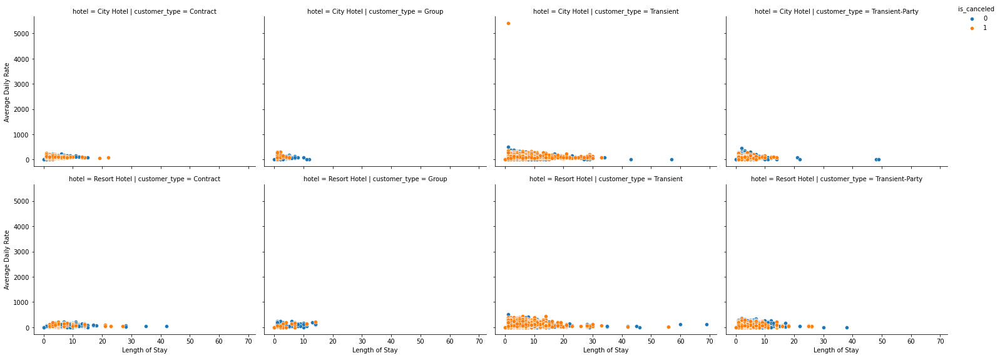

In [16]:
g = sns.FacetGrid(hotel, col='customer_type', row = 'hotel', hue="is_canceled", height=4, aspect=4/3)
g.map(sns.scatterplot, "length_of_stay", "adr")
g.set_axis_labels("Length of Stay", "Average Daily Rate")
g.add_legend(loc = 1)

There appears to be outliers in length of stay, especially for `customer_type` Transient and Transient-Party. We also note one extreme value Average Daily Rate (~$5400) for `customer_type` Transient. With extreme values in both ADR and length of stay, we are unable to tease out any visual information about the relationships in the data. We will look to various techniques to normalize the data so that we can handle outliers.

### Summary Stats For Continous Variables

We need to norm these somehow, either min/max or Z-norming. The level of outliers may cause issues with scale even with min/max-norming, I would lean toward the Z-norming (done below). lead_time, days_in_waiting_list, adr would dominate the other continous variables due to their scale - days and monetary value respectively.

According to https://www.codecademy.com/articles/normalization min/max norming guarantees variables on the same scale but handles outliers poorly. While mean norming (z score) cant guarantee the same scale (still much closer than the original) but handles outliers better.



### Mean Normalization

In [17]:
# Mean Normalization of the Continous Variables -  still contains large outliers pictured in graphs below
hotelCont_mean_normed = (hotelCont-hotelCont.mean())/(hotelCont.std())

# and adding is_canceled back in for analysis puposes
hotelCont_mean_normed.insert(0, 'is_canceled', hotel['is_canceled'])


In [18]:
# Creating an intermediate mean normed set to display outliers or scale issues, includes categorical and date attributes
Mean_Normed_Temp = pd.concat([hotelCont_mean_normed, hotelCats, hotelDates], axis = 1, join = 'inner')

# Quality check on merged data
Mean_Normed_Temp.shape

(119390, 34)

In [19]:
# Removing duplicate columns
Mean_Normed_Temp = Mean_Normed_Temp.loc[:,~Mean_Normed_Temp.columns.duplicated()]

# Source:
# https://stackoverflow.com/questions/32041245/fast-method-for-removing-duplicate-columns-in-pandas-dataframe

# Quality check on merged data - duplicate columns removed
Mean_Normed_Temp.shape

(119390, 33)

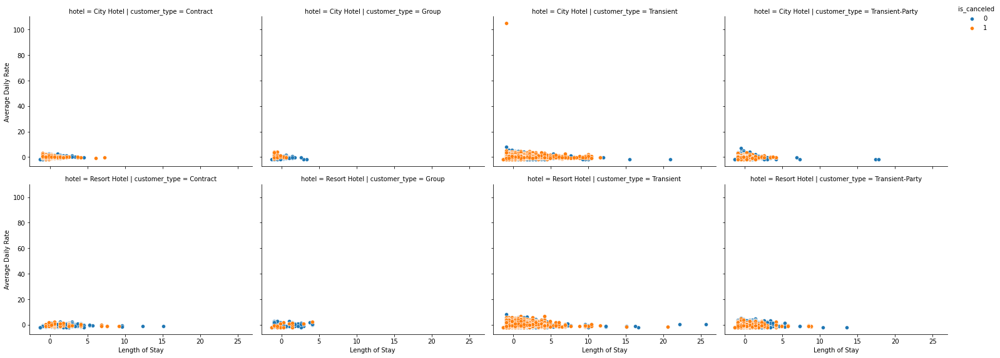

In [20]:
# Displays the same facets but now with mean normed continous variables (outliers still present and an issue)
g = sns.FacetGrid(Mean_Normed_Temp, col='customer_type', row = 'hotel', hue="is_canceled", height=4, aspect=4/3)
g.map(sns.scatterplot, "length_of_stay", "adr")
g.set_axis_labels("Length of Stay", "Average Daily Rate")
g.add_legend(loc = 1)

After Mean Normalization of the continous variables, outliers and extreme values are still present. Moving on to the next normalization technique.

### Min Max Normalization

In [21]:
# Min/maxed normalized - looking at this describe is nicer than the others - smashes all the data between 0 and 1
hotelCont_minmax_normed = (hotelCont-hotelCont.min())/(hotelCont.max()-hotelCont.min())

# and adding is_canceled back in for analysis puposes
hotelCont_minmax_normed.insert(0, 'is_canceled', hotel['is_canceled'])

In [22]:
# Creating an intermediate Min Max normed set to display outliers or scale issues, includes categorical and date attributes
MinMax_Normed_Temp = pd.concat([hotelCont_minmax_normed, hotelCats, hotelDates], axis = 1, join = 'inner')

# Quality check on merged data
MinMax_Normed_Temp.shape

(119390, 34)

In [23]:
# Removing duplicate columns
MinMax_Normed_Temp = MinMax_Normed_Temp.loc[:,~MinMax_Normed_Temp.columns.duplicated()]
 
# Source:
# https://stackoverflow.com/questions/32041245/fast-method-for-removing-duplicate-columns-in-pandas-dataframe

# Quality check on merged data - duplicate columns removed
MinMax_Normed_Temp.shape

(119390, 33)

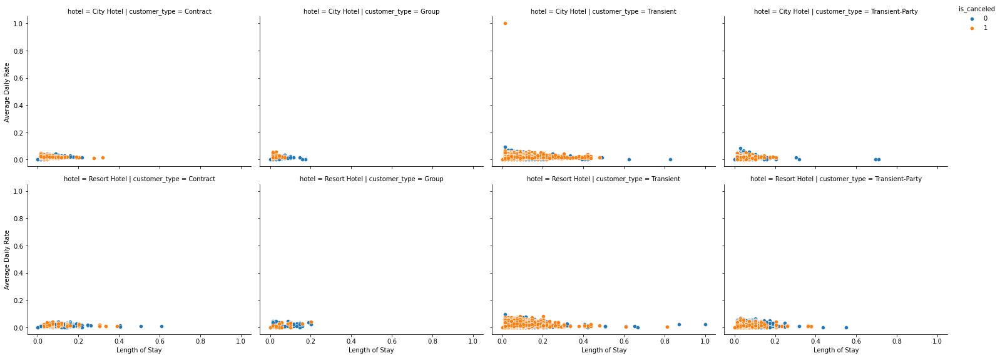

In [24]:
# Displays the same facets but now with min/max normed continous variables (outliers still present and an issue)
g = sns.FacetGrid(MinMax_Normed_Temp, col='customer_type', row = 'hotel', hue="is_canceled", height=4, aspect=4/3)
g.map(sns.scatterplot, "length_of_stay", "adr")
g.set_axis_labels("Length of Stay", "Average Daily Rate")
g.add_legend(loc = 1)

The min max norming forces an equal scale on all of our variables, but due to the extreme outliers present, the data is still crunched and not very useful visually. It seems we will have to cut out some outliers to visualize these columns appropriately. It is hardly useful to draw any conclusions about relationships in the data from this perspective with min/max norming.

### Z Normalization
Created the `hotel_nol` df or hotel with no outliers. Outliers that were greater than 5 standard devs out were removed from the data frame.

5 std.devs was chosen due the size of our data set. A 1/100,000 chance corresponds to an approximate 4.26 Z-score, so we rounded up to the nearest integer from there.



In [25]:
hotel_nol = hotelCont_mean_normed[(np.abs(hotelCont_mean_normed) < 5).all(axis=1)]

# Data Description - z-normalized without the outliers
hotel_nol.describe()

,lead_time,arrival_date_week_number,stays_in_weekend_nights,stays_in_week_nights,length_of_stay,previous_cancellations,previous_bookings_not_canceled,booking_changes,days_in_waiting_list,adr,required_car_parking_spaces,total_of_special_requests,adults,children,babies,total_revenue
count,115232.000000,115232.000000,115232.000000,115232.000000,115232.000000,115232.000000,115232.000000,115232.000000,115232.000000,115232.000000,115232.000000,115232.000000,115232.000000,115232.000000,1.152320e+05,115232.000000
mean,-0.009892,-0.000554,-0.023360,-0.035361,-0.035507,-0.040462,-0.053044,-0.049604,-0.073151,-0.006872,-0.008245,-0.010741,-0.002937,-0.010648,-8.157892e-02,-0.035396
std,0.994596,0.999700,0.937205,0.884034,0.874183,0.272161,0.295707,0.783124,0.419556,0.928508,0.971920,0.984140,0.841819,0.970610,5.225010e-14,0.879937
min,-0.973315,-1.923183,-0.928887,-1.310234,-1.340365,-0.103179,-0.091554,-0.338988,-0.131923,-2.015040,-0.254872,-0.720691,-3.204779,-0.260658,-8.157892e-02,-1.065316
25%,-0.804875,-0.820659,-0.928887,-0.786204,-0.558332,-0.103179,-0.091554,-0.338988,-0.131923,-0.629878,-0.254872,-0.720691,0.247896,-0.260658,-8.157892e-02,-0.630675
50%,-0.336986,-0.012140,0.072502,-0.262173,-0.167316,-0.103179,-0.091554,-0.338988,-0.131923,-0.135177,-0.254872,-0.720691,0.247896,-0.260658,-8.157892e-02,-0.277603
75%,0.505213,0.796378,1.073890,0.261857,0.223700,-0.103179,-0.091554,-0.338988,-0.131923,0.474295,-0.254872,0.540664,0.247896,-0.260658,-8.157892e-02,0.244600
max,4.912721,1.898902,4.078056,4.978132,4.915895,4.634269,4.583100,4.260083,4.926412,4.983396,3.821916,4.324728,3.700571,4.757468,-8.157892e-02,4.998708


In [26]:
hotel_nol.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 115232 entries, 0 to 119389
Data columns (total 17 columns):
 #   Column                          Non-Null Count   Dtype   
---  ------                          --------------   -----   
 0   is_canceled                     115232 non-null  category
 1   lead_time                       115232 non-null  float64 
 2   arrival_date_week_number        115232 non-null  float64 
 3   stays_in_weekend_nights         115232 non-null  float64 
 4   stays_in_week_nights            115232 non-null  float64 
 5   length_of_stay                  115232 non-null  float64 
 6   previous_cancellations          115232 non-null  float64 
 7   previous_bookings_not_canceled  115232 non-null  float64 
 8   booking_changes                 115232 non-null  float64 
 9   days_in_waiting_list            115232 non-null  float64 
 10  adr                             115232 non-null  float64 
 11  required_car_parking_spaces     115232 non-null  float64 
 12  to

In [27]:
# Creating the normed full data set w/out outliers above 5 std.devs, includes categorical and date attributes
normed_full_nol = pd.concat([hotel_nol, hotelCats, hotelDates], axis = 1, join = 'inner')

# Quality check on merged data
normed_full_nol.shape

(115232, 34)

In [28]:
# Removing duplicate columns
normed_full_nol = normed_full_nol.loc[:,~normed_full_nol.columns.duplicated()]

# Source:
# https://stackoverflow.com/questions/32041245/fast-method-for-removing-duplicate-columns-in-pandas-dataframe

# Quality check on merged data - duplicate columns removed
normed_full_nol.shape

(115232, 33)

In [29]:
obs_lost = (len(hotel) - len(normed_full_nol))
percent_lost = round(obs_lost/len(hotel)*100,2)

print(f"Removing outliers beyond 5 standard deviations resulted in a loss of {obs_lost} observations or ~{percent_lost}% of total obs.\n",
"We think this is an accetable loss in order to be able to really visualize our data. Some of these extreme outliers are not indicative \n",
"of normal trends, or we do not have enough observations as extreme to be able to model them effectively.")

Removing outliers beyond 5 standard deviations resulted in a loss of 4158 observations or ~3.48% of total obs.
 We think this is an accetable loss in order to be able to really visualize our data. Some of these extreme outliers are not indicative 
 of normal trends, or we do not have enough observations as extreme to be able to model them effectively.


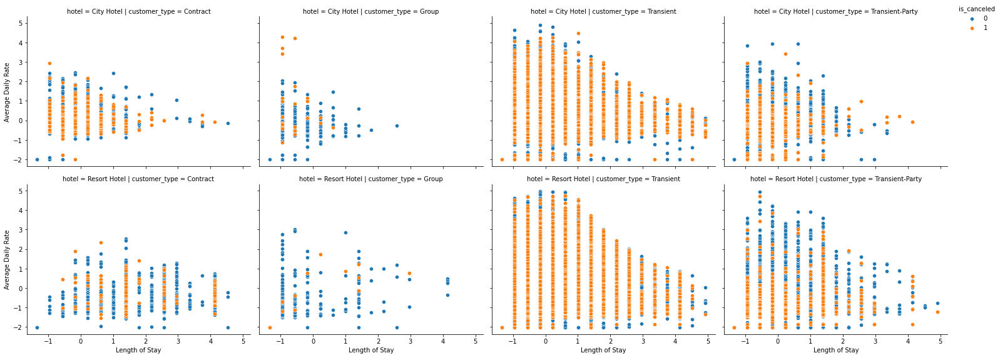

In [30]:
# Displays the same facets but now without the extreme outliers
g = sns.FacetGrid(normed_full_nol, col='customer_type', row = 'hotel', hue="is_canceled", height=4, aspect=4/3)
g.map(sns.scatterplot, "length_of_stay", "adr")
g.set_axis_labels("Length of Stay", "Average Daily Rate")
g.add_legend(loc = 1)

We can finally start to see some of the patterns within the data once we have z-normed the data and filtered out any outliers that are beyond 5 standard deviations. 

From this we can see that Transient customer type makes up the block of reservations, and consequently also has the highest number of cancelations.

Group reservations by far had the lowest number of cancelations. 

It looks as though, for Resort Hotels for Transient-Party customer group, as both the length of stay and ADR increase, cancelations tend to decrease.

In almost all groups, across both htoel types, as length of stay increases, ADR decreases, and we see a negative relationship between ADR and length of stay. This could be attributed to a few things - discounted rates for longer stays, or increased lead time for longer stays could mean lower rates. We should investigate the relationship between lead time and length of stay and lead time and ADR.

Between the two hotel types, the shape of the data is very similar between customer types except for a slight difference in Contract and Group type customers.

# Data Meaning and Type

### Descriptions

####hotel (categorical): 
<ul>This data was collected from two hotels, each 
of a different type </ul>
 
- **Resort Hotel**  
- **City Hotel**  


---


####is_canceled (categorical):
<ul>This column identifies whether the booking ended up being canceled</ul>


- **1** - yes  
- **2** - no


---


####lead_time (continuous):
<ul><b>days elapsed</b> between entering date of booking and arrival date</ul>


---


####arrival_date_week_number (continuous):
<ul><b>week number</b> of year for arrival date</ul>


---

####stays_in_weekend_nights (continuous):
<ul><b>Number of weekend nights</b> (Saturday or Sunday) the guest stayed or booked to stay at the hotel

Our group determined that when weekend and week nights are both 0 for a guest (and they didn't cancel), that means they were only sold on a day rate. They didn't stay overnight. You might see this with rooms used for meetings, or trunk shows for example.</ul>

---


####stays_in_week_nights (continuous):
<ul><b>Number of week nights</b> (Monday to Friday) the guest stayed or booked to stay at the hotel

Our group determined that when weekend and week nights are both 0 for a guest (and they didn't cancel), that means they were only sold on a day rate. They didn't stay overnight. You might see this with rooms used for meetings, or trunk shows for example.</ul>

---


####adults (continuous):	
<ul><b>number of adults</b>

The hotels in this dataset didn't seem to have a requirement for at least one adult. We don't have enough information to know, so 0 is considered valid here.</ul>


---


####children (continuous):
<ul><b>number of children</b></ul>
	

---


####babies (continuous):
<ul><b>number of babies</b></ul>
	

---


####meal (categorical):
<ul>Type of meal booked. Categories are presented in standard hospitality meal packages:</ul> 

- **Undefined/SC** – no meal package  
- **BB** – Bed & Breakfast  
- **HB** – Half board (breakfast and one other meal – usually dinner)  
- **FB** – Full board (breakfast, lunch and dinner)


---


####country (categorical):
<ul><b>Country of origin</b> - Categories are represented in the ISO 3155–3:2013 format</ul>


---


####market_segment (categorical):
<ul>Market segment designation</ul> 

- **TA** - Travel Agents  
- **TO** - Tour Operators 


---


####distribution_channel (categorical):
<ul>Booking distribution channel</ul>  

- **TA** - Travel Agents  
- **TO** - Tour Operators


---


####is_repeated_guest (categorical):
<ul>Value indicating if the booking name was from a repeated guest</ul>

- **1** - repeated guest  
- **0** - not repeated guest


---


####previous_cancellations (continuous):
<ul><b>Number of previous bookings that were cancelled</b> by the customer prior to the current booking</ul>


---


####previous_bookings_not_canceled (continuous):
<ul><b>Number of previous bookings not cancelled</b> by the customer prior to the current booking</ul>


---


####reserved_room_type (categorical):
<ul><b>Code of room type reserved</b>. Code is presented instead of designation for anonymity reasons</ul>


---


####assigned_room_type (categorical):
<ul><b>Code for the type of room assigned</b> to the booking. Sometimes the assigned room type differs from the reserved room type due to hotel operation reasons (e.g. overbooking) or by customer request. Code is presented instead of designation for anonymity reasons</ul>


---


####booking_changes (continuous):
<ul><b>Number of changes/amendments</b> made to the booking from the moment the booking was entered on the PMS until the moment of check-in or cancellation</ul>


---


####deposit_type (categorical):
<ul>Indication on if the customer made a deposit to guarantee the booking. This variable can assume three categories:</ul>

- **No Deposit** – no deposit was made  
- **Non Refund** – a deposit was made in the value of the total stay cost  
- **Refundable** – a deposit was made with a value under the total cost of stay


---


####agent (categorical):
<ul><b>ID of the travel agency</b> that made the booking</ul>


---


####company (categorical):
<ul><b>ID of the company/entity</b> that made the booking or responsible for paying the booking. ID is presented instead of designation for anonymity reasons</ul>


---


####days_in_waiting_list (continuous):
<ul><b>Number of days the booking was in the waiting list</b> before it was confirmed to the customer</ul>


---


####customer_type (categorical):
<ul>Type of booking, assuming one of four categories:</ul>

- **Contract** - when the booking has an allotment or other type of contract associated to it  
- **Group** – when the booking is associated to a group  
- **Transient** – when the booking is not part of a group or contract, and is not associated to other transient booking  
- **Transient-party** – when the booking is transient, but is associated to at least other transient booking


---


####adr (continuous):
<ul><b>Average Daily Rate</b> is defined by dividing the sum of revenue by the total number of staying nights at the booking level.

Our group assumes this is in USD, as it is not stated anywhere in the source paper. </ul>


---


####required_car_parking_spaces (continuous):
<ul><b>Number of car parking spaces</b> required by the customer</ul>


---


####total_of_special_requests (continuous):
<ul><b>Number of special requests</b> made by the customer (e.g. twin bed or high floor)</ul>


---


####reservation_status (categorical):
<ul>Reservation last status, assuming one of three categories: </ul>

- **Canceled** – booking was canceled by the customer  
- **Check-Out** – customer has checked in but already departed  
- **No-Show** – customer did not check-in and did inform the hotel of the reason why


---


####reservation_status_date (datetime):
<ul><b>Date at which the last status was set</b>. This variable can be used in conjunction with the Reservation_Status to understand when was the booking canceled or when did the customer check-out of the hotel</ul>


---

####arrival_date (datetime):
<ul>Dervide column: It is the <b>date the guest checked in</b>. This was created by our group using the variables arrival_date year, arrival_date_month, and arrival_date_day_of_month</ul>


---


###departure_date (datetime):
<ul>Dervived column: This was created by our group by adding arrival_date and length_of_stay. It is the <b>date the guest checked out</b>, if they were not a cancelation</ul>


---


####length_of_stay (continuous):
<ul>Dervived column: This was created by our group using stays_in_weekend_nights and stays_in_week_nights. It is the <b>total number of nights</b> the guest stayed at the hotel</ul>

---

####total_revenue (continuous):
<ul>Dervived column: The <b>total revenue derived</b> by multiplying ADR (Average Daily Rate) by Length of Stay. 

Our group assumes this is in USD.</ul>

---


###Source
https://www.sciencedirect.com/science/article/pii/S2352340918315191

### Info

In [31]:
# After cleanup, normalization, and removal of outliers beyond 5 standard deviations
normed_full_nol.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 115232 entries, 0 to 119389
Data columns (total 33 columns):
 #   Column                          Non-Null Count   Dtype         
---  ------                          --------------   -----         
 0   is_canceled                     115232 non-null  category      
 1   lead_time                       115232 non-null  float64       
 2   arrival_date_week_number        115232 non-null  float64       
 3   stays_in_weekend_nights         115232 non-null  float64       
 4   stays_in_week_nights            115232 non-null  float64       
 5   length_of_stay                  115232 non-null  float64       
 6   previous_cancellations          115232 non-null  float64       
 7   previous_bookings_not_canceled  115232 non-null  float64       
 8   booking_changes                 115232 non-null  float64       
 9   days_in_waiting_list            115232 non-null  float64       
 10  adr                             115232 non-null  float64

# Simple Statistics

See also -  
- <a target="_self" href="https://colab.research.google.com/drive/1AoIKPl-hSjqTj-gzBb7u9xEGqDZxO9Kt#scrollTo=c_dOoD7gOKlr&line=2&uniqifier=1">Data Quality: Summary Statistics</a> 
- <a target="_self" href="https://colab.research.google.com/drive/1AoIKPl-hSjqTj-gzBb7u9xEGqDZxO9Kt#scrollTo=5cafOQLfZ8MF&line=2&uniqifier=1">Data Quality: Non-normed Continuous Data</a> 
- <a target="_self" href="https://colab.research.google.com/drive/1AoIKPl-hSjqTj-gzBb7u9xEGqDZxO9Kt#scrollTo=zjs5gbI2ih2f&line=3&uniqifier=1">Data Quality: Summary Stats for Continuous Variables</a> 





In [32]:
normed_full_nol.describe()

,lead_time,arrival_date_week_number,stays_in_weekend_nights,stays_in_week_nights,length_of_stay,previous_cancellations,previous_bookings_not_canceled,booking_changes,days_in_waiting_list,adr,required_car_parking_spaces,total_of_special_requests,adults,children,babies,total_revenue
count,115232.000000,115232.000000,115232.000000,115232.000000,115232.000000,115232.000000,115232.000000,115232.000000,115232.000000,115232.000000,115232.000000,115232.000000,115232.000000,115232.000000,1.152320e+05,115232.000000
mean,-0.009892,-0.000554,-0.023360,-0.035361,-0.035507,-0.040462,-0.053044,-0.049604,-0.073151,-0.006872,-0.008245,-0.010741,-0.002937,-0.010648,-8.157892e-02,-0.035396
std,0.994596,0.999700,0.937205,0.884034,0.874183,0.272161,0.295707,0.783124,0.419556,0.928508,0.971920,0.984140,0.841819,0.970610,5.225010e-14,0.879937
min,-0.973315,-1.923183,-0.928887,-1.310234,-1.340365,-0.103179,-0.091554,-0.338988,-0.131923,-2.015040,-0.254872,-0.720691,-3.204779,-0.260658,-8.157892e-02,-1.065316
25%,-0.804875,-0.820659,-0.928887,-0.786204,-0.558332,-0.103179,-0.091554,-0.338988,-0.131923,-0.629878,-0.254872,-0.720691,0.247896,-0.260658,-8.157892e-02,-0.630675
50%,-0.336986,-0.012140,0.072502,-0.262173,-0.167316,-0.103179,-0.091554,-0.338988,-0.131923,-0.135177,-0.254872,-0.720691,0.247896,-0.260658,-8.157892e-02,-0.277603
75%,0.505213,0.796378,1.073890,0.261857,0.223700,-0.103179,-0.091554,-0.338988,-0.131923,0.474295,-0.254872,0.540664,0.247896,-0.260658,-8.157892e-02,0.244600
max,4.912721,1.898902,4.078056,4.978132,4.915895,4.634269,4.583100,4.260083,4.926412,4.983396,3.821916,4.324728,3.700571,4.757468,-8.157892e-02,4.998708


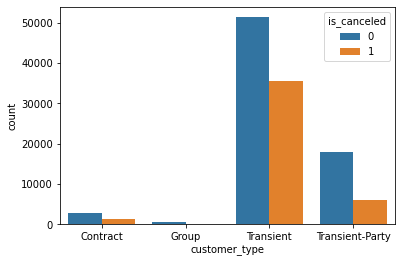

In [33]:
# The following chart shows customer type count. We notice that both of the hotel 
# types have more 'Transient' customers than any other customer types

customer_typeplt = sns.countplot(x="customer_type", hue ="is_canceled", data=normed_full_nol)

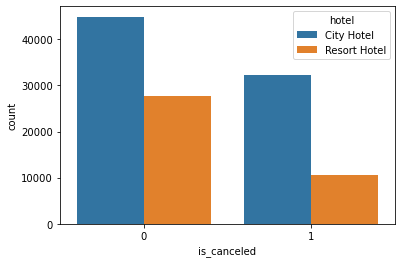

In [34]:
# The following chart shows cancellation data by hotel type

cancelation_by_hotel = sns.countplot(x="is_canceled", hue ="hotel", data=normed_full_nol)

<AxesSubplot:title={'center':'Demand by Arrival Date'}, xlabel='arrival_date'>

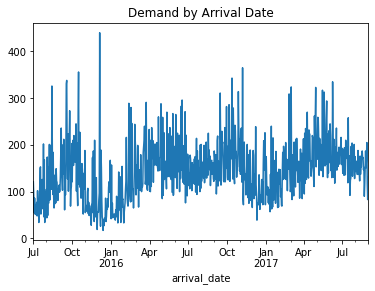

In [35]:
# Demand by arrival date 

arrivemonth_dist = normed_full_nol.groupby("arrival_date").size()
arrivemonth_dist.plot (title = "Demand by Arrival Date")

<AxesSubplot:ylabel='country'>

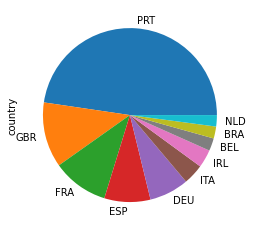

In [36]:
# Top Countries by Bookings (Top 10)
temp = normed_full_nol.country.value_counts().sort_values(ascending=False).head(10)
temp.plot(kind='pie')

In [37]:
# Trying to unstanding which months have most (or least) cancellations

normed_full_nol_months = normed_full_nol[["arrival_date","is_canceled"]]
normed_full_nol_months["is_canceled"] = normed_full_nol_months["is_canceled"].astype(int)
normed_full_nol_months.groupby(normed_full_nol_months["arrival_date"].dt.strftime('%b'))["is_canceled"].sum()

/home/bensonnd/anaconda3/envs/ml1-7331/lib/python3.7/site-packages/ipykernel_launcher.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  after removing the cwd from sys.path.


arrival_date
Apr    4431
Aug    5050
Dec    2274
Feb    2653
Jan    1731
Jul    4585
Jun    4469
Mar    2974
May    4478
Nov    2090
Oct    4095
Sep    3950
Name: is_canceled, dtype: int64

Text(0.5, 1.0, 'Total Revenue Per Year (in millions)')

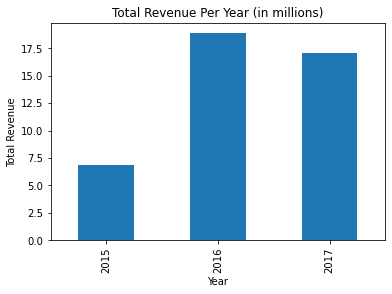

In [38]:
# Revenue Breakdown by Arrival Year and total revenue
# plotting sums per year of total revenue. setting values on a scale of millions for 
# easier viewing in plot
hg = hotel.groupby(by=pd.DatetimeIndex(hotel['arrival_date']).year)['total_revenue'].sum()

hg = hg.div(1000000).round(2)

hg.plot(kind='bar') 
plt.xlabel('Year')
plt.ylabel('Total Revenue')
plt.title("Total Revenue Per Year (in millions)")


#adapted from 
#https://discuss.analyticsvidhya.com/t/how-can-we-plot-a-bar-chart-with-categorical-values-on-x-axis-in-python/1046

#and
#https://pythonprogramming.net/legends-titles-labels-matplotlib-tutorial/


<AxesSubplot:xlabel='deposit_type'>

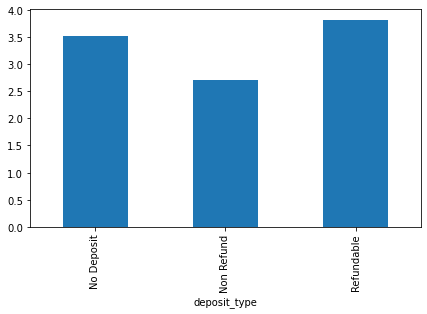

In [39]:
# Length_of_stay by deposit types
fig = plt.figure(figsize =(7, 4)) 

# Horizontal Bar Plot 
dtg = hotel.groupby(by=hotel.deposit_type)['length_of_stay'].mean()


dtg.plot(kind = 'bar') 


### Attributes Explanation

In order to understand the drivers for demand for the rooms at the hotels (both resort and city hotels), we need to look into different customer types, business transaction types and date types by Average Daily Rates and length of stay. Fig_TC 1 to Fig_TC 8 show provide us the breakdown which can assist us to see where the demand lies for the business. Most of these customers are coming from Europe as Transient type. These customers are not associated with any group bookings nor any contract. Fig_TC 5 tells us that most of the daily revenue has been generated directly from customers as the range of the whiskers are longer than rest three types. We do notice offline travel agents and tour operators driving the revenue after direct purchase. From fig_TC 1, we also notice the same parallel effect in terms of length of stays as customers from both of those market segment stay longer. Fig_TC.7 shows us the positive relationship between days in waiting list period and lead time. Most of the data is around the early waiting days which can assist analysts or company executives to manage the logistics of hotel rooms before the customers arrive.

In terms months and date variables, fig_TC 2 shows us that there tends to be more bookings around Novembers and then around Julys- Augusts. In terms of cancellations and check outs, Julys tend to have both the most cancellation and check-outs. Also, city hotels tend to have more cancellations than resort hotels (Fig_TC 4).

'Meal' category tells us that most people check-out under the bed and breakfast category (Fig_TC 8). There are customers under 'half board - breakfast and one other meal' category but they do not drive the demand as much as customers who pick bed and breakfast only.

### Revenue Analysis:

A Revenue feature "total_revenue" has been added to our dataframe by multiplying length of stay to the average daily rate. Total revenue for three year period was around $41 million. The breakdown from Fig_TC 10 shows the total revenue by yearly period. We have noticed that revenue has increased dramatically from 2016 to 2017 by 174%.Customers, who get the option of refunds, stays more longer (Fig_TC.11). Another feature that can help us to understand revenue growth is to look into market segments. There two figurues in Fig_TC.12 - Total Revenue by Market Segment and Length of Stay by Market Segment. Both figures show most of the non-repeating customers drive the revenue growth by staying longer. Online and offline travel agents tend to book the hotel rooms more. We also notice customers from aviation industries driving the revenue with higher length of stay. In terms of type of hotel, resorts tend to drive total revenue as expected. But It also tends to have customers who cancels more than city hotel customers. 

# Visualize Attributes

(array([0, 1, 2, 3, 4, 5, 6, 7]),
 [Text(0, 0, 'Aviation'),
  Text(1, 0, 'Complementary'),
  Text(2, 0, 'Corporate'),
  Text(3, 0, 'Direct'),
  Text(4, 0, 'Groups'),
  Text(5, 0, 'Offline TA/TO'),
  Text(6, 0, 'Online TA'),
  Text(7, 0, 'Undefined')])

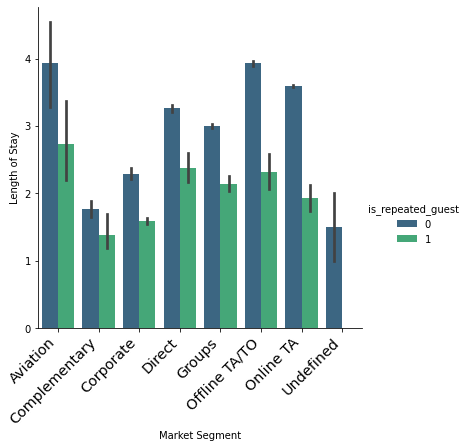

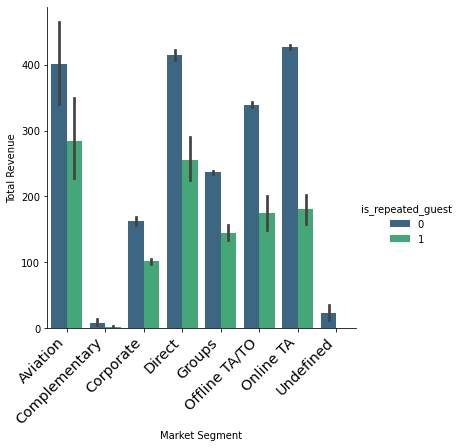

In [40]:
#   Length_of_stay by Market Segment
ax= sns.catplot(x="market_segment", y="length_of_stay", hue = 'is_repeated_guest', palette = 'viridis', kind="bar", data=hotel)
ax.set_titles('Length of Stay by Market Segment')
ax.set_ylabels ('Length of Stay')
ax.set_xlabels ('Market Segment')
plt.xticks(
    rotation=45, 
    horizontalalignment='right',
    fontweight='light',
    fontsize='x-large'  
)

rv= sns.catplot(x="market_segment", y="total_revenue", hue = 'is_repeated_guest', palette = 'viridis', kind="bar", data=hotel)
rv.set_titles('Revenue by Market Segment')
rv.set_ylabels ('Total Revenue')
rv.set_xlabels ('Market Segment')
plt.xticks(
    rotation=45, 
    horizontalalignment='right',
    fontweight='light',
    fontsize='x-large'  
)

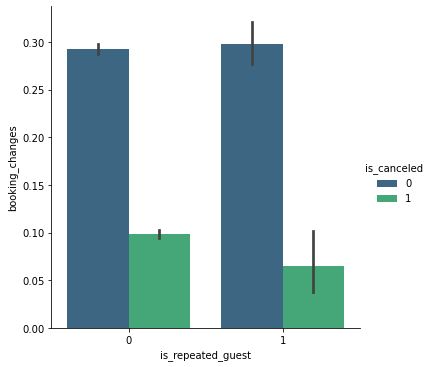

In [41]:
#Fig 13 - Booking changes by customer. 
sns.catplot(x="is_repeated_guest", y="booking_changes", hue = 'is_canceled', palette = 'viridis', kind="bar", data=hotel)

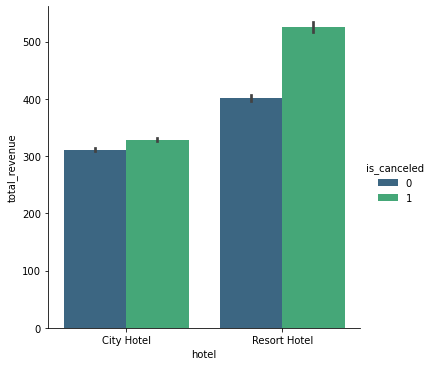

In [42]:
#Fig_13 bar plot for revenue by hotel type
#plotting sums per year of total revenue. setting values on a scale of millions for 
#easier viewing in plot
sns.catplot(x="hotel", y="total_revenue", hue = 'is_canceled', palette = 'viridis', kind="bar", data=hotel)

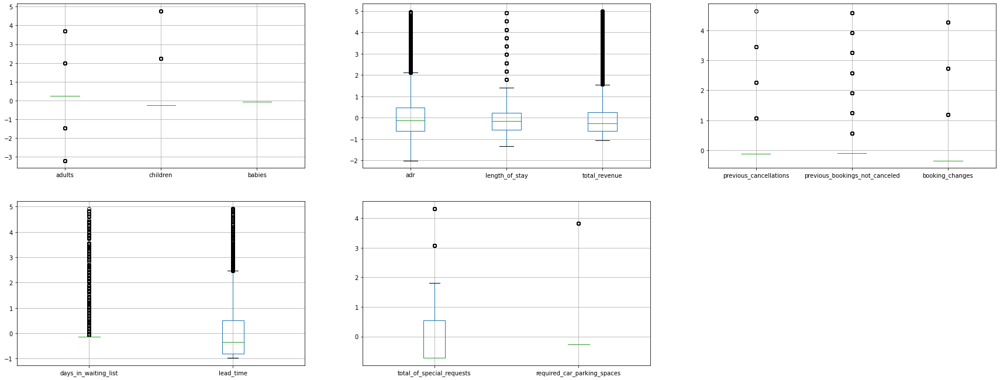

In [43]:
# lets look at the boxplots separately
# acquired from asynch notebook
# can still see that outliers are an issue in some features even though we've cut down 

vars_to_plot_separate = [
                         ['adults','children','babies'],
                         ['adr', 'length_of_stay', 'total_revenue'],
                         ['previous_cancellations','previous_bookings_not_canceled','booking_changes'],
                         ['days_in_waiting_list','lead_time'],
                         ['total_of_special_requests','required_car_parking_spaces']
                        ]

plt.figure(figsize=(30, 30))

for index, plot_vars in enumerate(vars_to_plot_separate):
    plt.subplot(len(vars_to_plot_separate), 3, index+1)
    ax = normed_full_nol.boxplot(column=plot_vars)
    


Many of our variables are very right skewed.  `Adr`, `adults`, and maybe `length_of_stay` are the only near-normal attributes.  However, our forced norming and trimming allows all our continuous variables to viewed on the same approximate scale. 

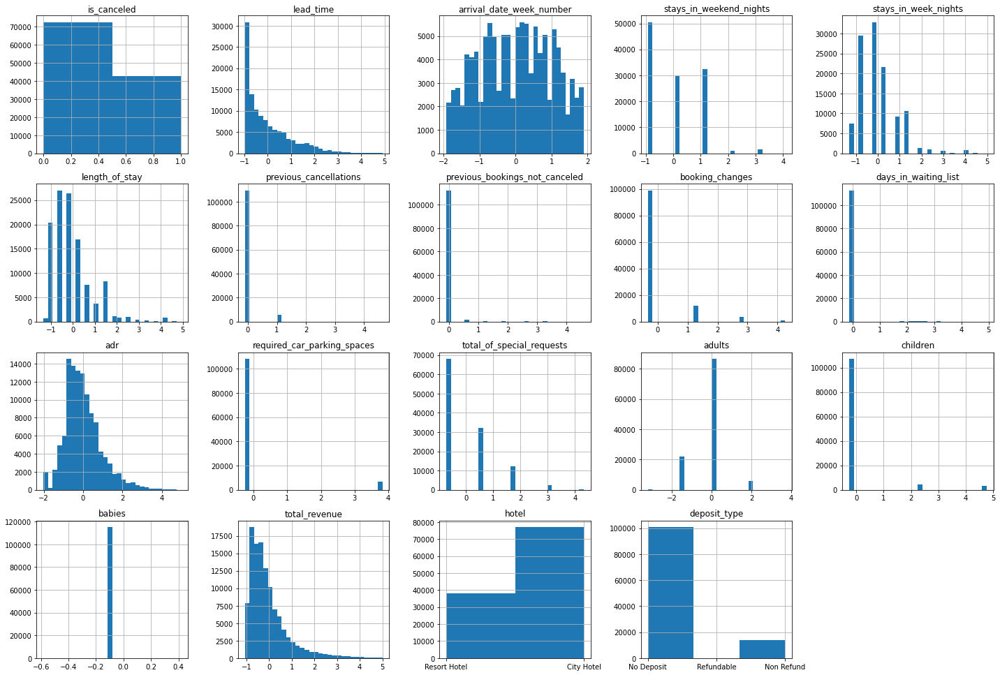

In [44]:
# some weird looking results here - might be some good candidates to turn into booleans
plt.figure(figsize=(20, 20))

# temporarily removing date columns just for this visualization
no_dates_cols = [col for col in normed_full_nol.columns if col not in hotelDates.columns]
normed_full_nol_no_dates = normed_full_nol[no_dates_cols]

for index, col in enumerate(no_dates_cols):
    # skip datetime and massive categoricals 
    if col in ["country","agent","company"] or normed_full_nol[col].dtype.name == "datetime64[ns]":
      break
    bins = 30
    if normed_full_nol[col].dtype.name == "category":
      bins = len(normed_full_nol[col].dtypes.categories)
    plt.subplot(6,5,index+1)
    normed_full_nol[col].hist(bins = bins)
    plt.title(normed_full_nol.columns[index])

plt.tight_layout()

Here we can see the distributions from the normed and trimmed data. `is_canceled` false has nearly double the observations of `is_canceled` true. Likewise, there are about double the observations for the city hotel than the resort hotel. Due to the large number of right skewed variables, when creating our models we will need to look into a log transform or possibly some other functional transformation.

# Explore Joint Attributes

### Z Normed Data With Outliers Removed
With the extreme outliers removed we can finally see some actual, meaningful relationships in our data. 


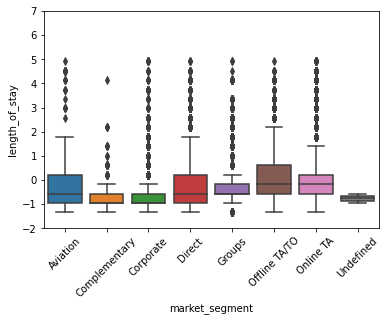

In [45]:
# length_of_stay Boxplot By Market Segment
plt.ylim(-2,7)
plt.xticks(rotation=45)

box2 = sns.boxplot(x='market_segment', y = 'length_of_stay', data = normed_full_nol )

Length of stay median values are generally clustered close together when looking at the distribution of length of stay by market segment. Other than Offline TA/TO having a higher median stay than other market segments, market segment may not be extraordinarly useful in regressing `length_of_stay` predictions. Every market segment has a rightly skew dsitribution. To note, this skew is still very present after normalizing the data to a z-score. Might consider exploring log transforming the repsonse variable `length_of_stay`.

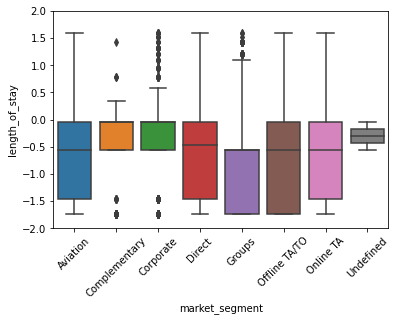

In [46]:
# length_of_stay Boxplot By Market Segment
plt.ylim(-2,2)
plt.xticks(rotation=45)

box2 = sns.boxplot(x='market_segment', y=np.log(abs(normed_full_nol['length_of_stay'])+.01), data = normed_full_nol )

# np.log(abs(normed_full_nol['length_of_stay'])+.01)

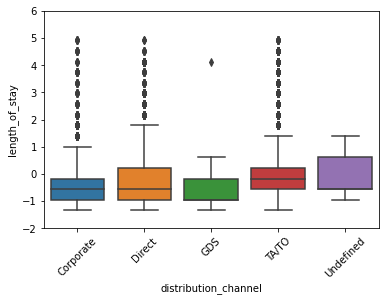

In [47]:
# length_of_stay Boxplot by Distribution Channel

plt.ylim(-2,6)
plt.xticks(rotation=45)

book_seg = sns.boxplot(x='distribution_channel', y = 'length_of_stay', data = normed_full_nol )

Length of stay median values are generally clustered close together when looking at the distribution of length of stay by market segment. Other than Offline TA/TO having a higher median stay than other market segments, market segment may not be extraordinarly useful in regressing `length_of_stay` predictions. Every market segment has a rightly skew dsitribution.

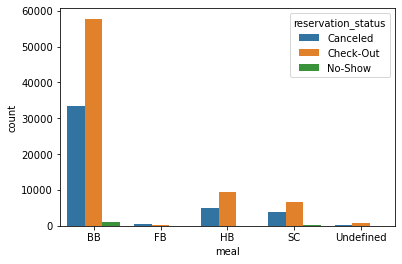

In [48]:
# ADR by meal plan
cancelation_by_hotel = sns.countplot(x="meal", hue ="reservation_status", data=hotel)

<AxesSubplot:ylabel='hotel,deposit_type'>

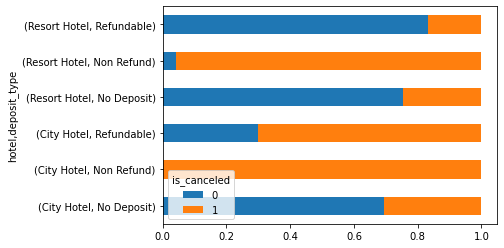

In [49]:
# Crosstab hotel and deposit type by cancelation 
Canceled_bydeposittype = pd.crosstab([normed_full_nol['hotel'], normed_full_nol['deposit_type']], normed_full_nol['is_canceled'])
Canceled_bydeposittype.div(Canceled_bydeposittype.sum(1),axis=0).plot.barh(stacked = True)

Cross Tabulated Hotel type and Deposit type, by cancelation decision
Biggest difference in the refundable class `deposit_type` between resort and city, close in non-refundable and no deposit

<AxesSubplot:ylabel='hotel,customer_type'>

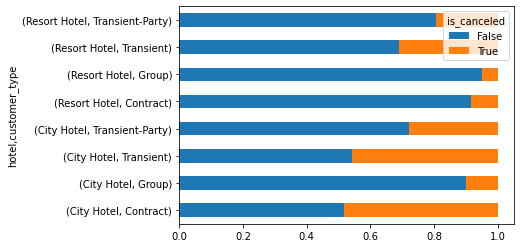

In [50]:
# crosstab hotel and customer type by cancelation
Canceled_bycustomertype = pd.crosstab([normed_full_nol['hotel'],normed_full_nol['customer_type']], 
                       normed_full_nol.is_canceled.astype(bool))
Canceled_bycustomertype.div(Canceled_bycustomertype.sum(1),axis=0).plot.barh(stacked = True)

Biggest difference between contract class of `customer_type`. City seems to have more cancelation in general.  Plans taking you to a city hotel are more likely to change than plans taking you to a resort possibly.

/home/bensonnd/anaconda3/envs/ml1-7331/lib/python3.7/site-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


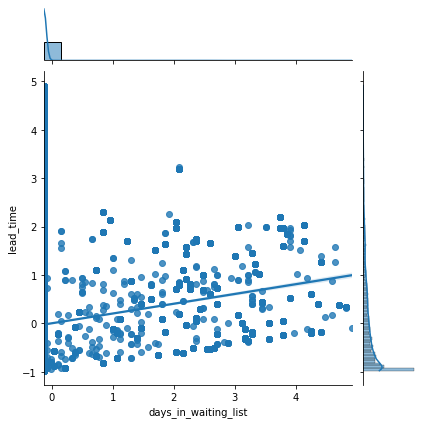

In [51]:
# Relationship between number of days in wait-list and lead time
sns.jointplot("days_in_waiting_list", "lead_time", data=normed_full_nol, kind='reg')

/home/bensonnd/anaconda3/envs/ml1-7331/lib/python3.7/site-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


<AxesSubplot:xlabel='lead_time', ylabel='length_of_stay'>

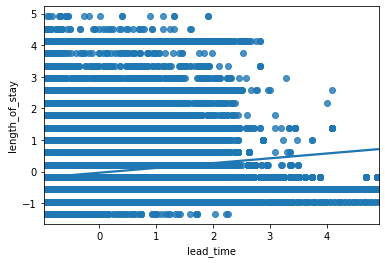

In [52]:
# Relationship between lead time and length of stay
sns.regplot(normed_full_nol.lead_time, normed_full_nol.length_of_stay)

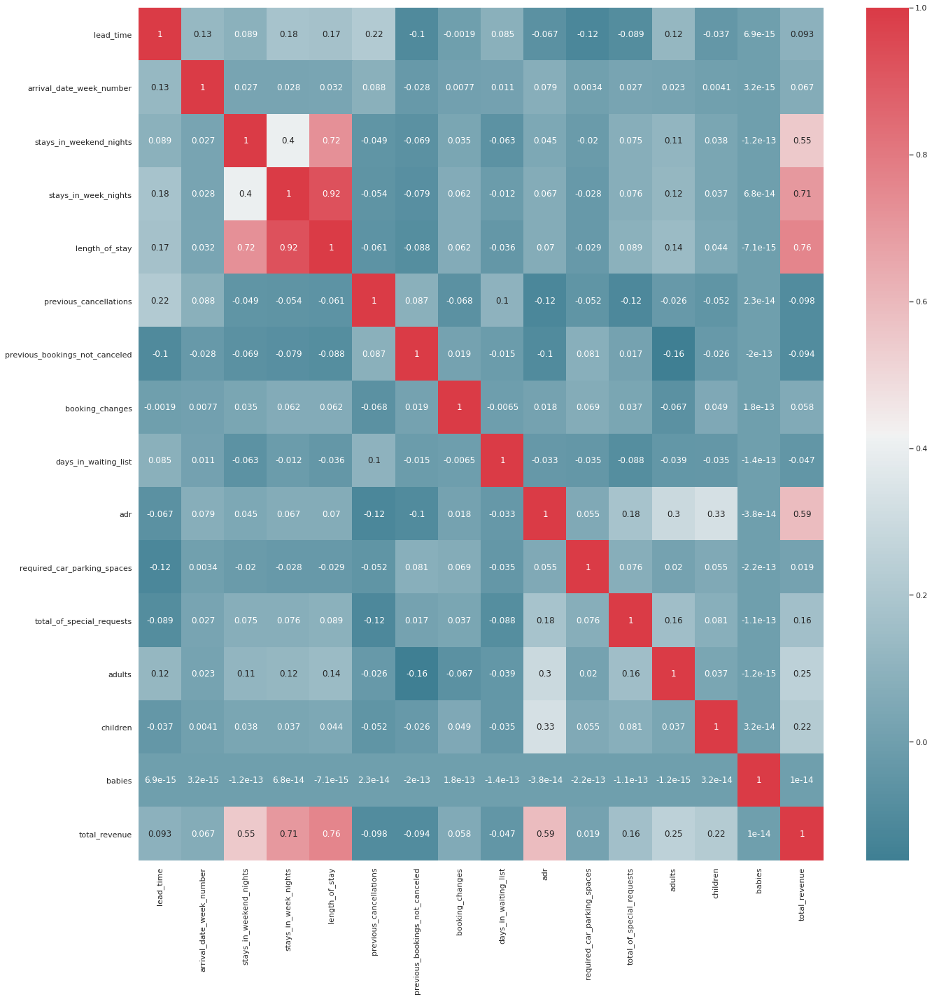

In [53]:
# plot the correlation matrix using seaborn
# nothing is highly correlated, children and adults lightly correlated with adr (doesn't adr take number of people into account?)

sns.set(style="darkgrid") # one of the many styles to plot using
cmap = sns.diverging_palette(220, 10, as_cmap=True) # one of the many color mappings
f, ax = plt.subplots(figsize=(20, 20))
sns.heatmap(normed_full_nol.corr(), cmap=cmap, annot=True)

f.tight_layout()

# Source:
# copied from asynch notebook

Correlation Matrix:

The correlations matrix plot using using the normalized data sans outliers tells us that there are not many strong relationships between the continuous features. With four additional features, we start to notice correlations with `length_of_stay` and `stays_in_week_nights` and `stays_in_weekend_nights` - this makes sense, because `length_of_stay` is derived from these two columns. Similarly, since `total_revenue` is a derivitive of `length_of_stay`, we notice similar relationship between those two attributes as well.

Because of the obvious colinearity between `stays_in_week_nights` and `stays_in_weekend_nights` and `length_of_stay` and `total_revenue`, it might make sense to explore encoding `stays_in_week_nights` and `stays_in_weekend_nights` as binaries - which would segment our bookings into four new categories:

* those who stayed weeknights
* those who stayed weekends
* those who stayed both
* those who stayed neither (daytime bookings)  

Other than that, there are surpisingly few colinear relationships in our data set among the continuous variables.

<AxesSubplot:xlabel='booking_changes', ylabel='adr'>

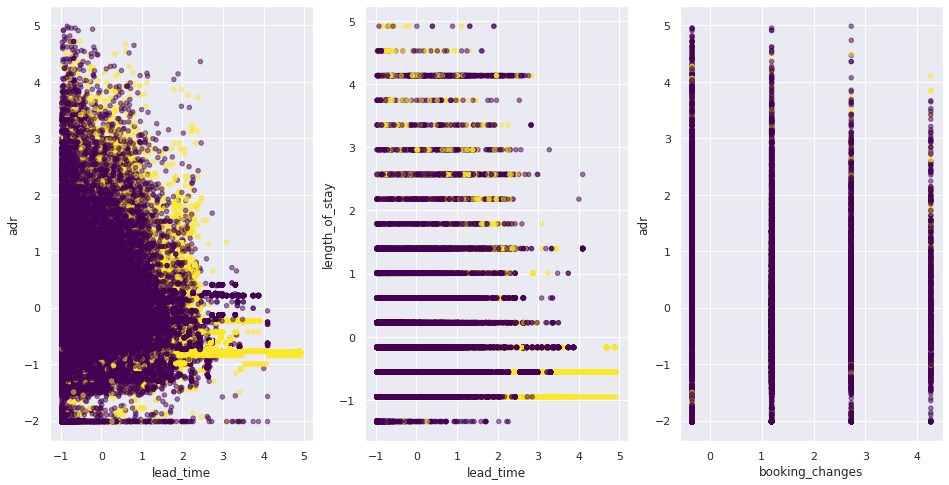

In [54]:
# showing a better view of the adr v leadtime colored by is_canceled
# some of the graphs look better as the orginal hotel, others as normed.

fig = plt.figure(3, figsize=(16,8))

ax1 = fig.add_subplot(1, 3, 1)
normed_full_nol.plot.scatter(x = "lead_time", y = "adr", c = normed_full_nol['is_canceled'], colormap = 'viridis', alpha = 0.5, ax=ax1)

ax2 = fig.add_subplot(1, 3, 2)
normed_full_nol.plot.scatter(x = "lead_time", y = "length_of_stay", c = normed_full_nol['is_canceled'], colormap = 'viridis', alpha = 0.5, ax=ax2)

ax3 = fig.add_subplot(1, 3, 3)
normed_full_nol.plot.scatter(x = "booking_changes", y = "adr", c = normed_full_nol['is_canceled'], colormap = 'viridis', alpha = 0.5, ax=ax3)

#adapted from https://towardsdatascience.com/master-the-art-of-subplots-in-python-45f7884f3d2e

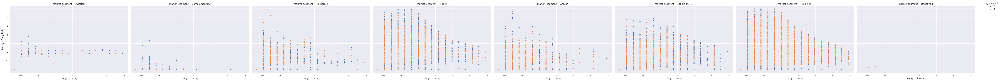

In [55]:
# this is a cool method!
# adapted from https://seaborn.pydata.org/generated/seaborn.FacetGrid.html
# Market_segment by LoS and ADR colored by is_canceled
# Complmentary has very little cancelations, offline TA/TO has many cancelations for lower LoS and adr +direct, +corporate, +online TA
# 
g = sns.FacetGrid(normed_full_nol, col='market_segment', hue="is_canceled", height=6, aspect=6/4)
g.map(sns.scatterplot, "length_of_stay", "adr")
g.set_axis_labels("Length of Stay", "Average Daily Rate")
g.add_legend(loc = 1)

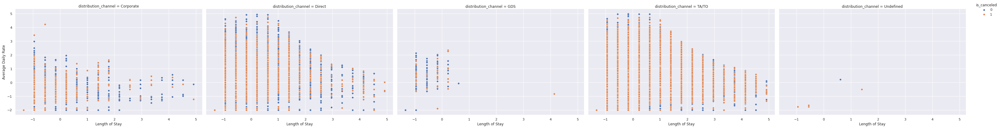

In [56]:
# another plot to compare categoricals on LoS and ADR
g = sns.FacetGrid(normed_full_nol, col='distribution_channel', hue="is_canceled", height=6, aspect=6/4)
g.map(sns.scatterplot, "length_of_stay", "adr")
g.set_axis_labels("Length of Stay", "Average Daily Rate")
g.add_legend(loc = 1)

#Explore Attributes and Class

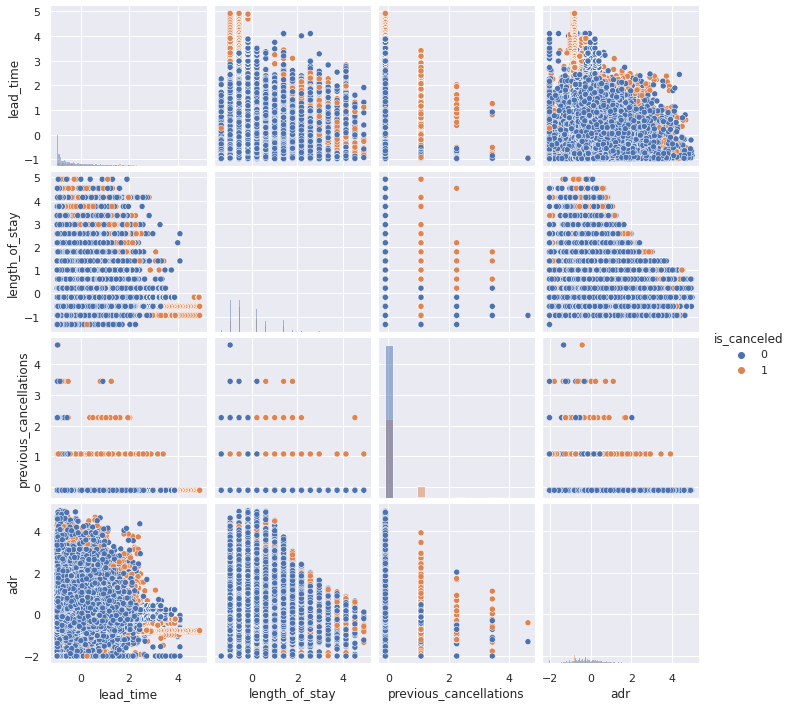

In [57]:
# looking at some continous variables colored by is_canceled. 
# run normed_full_nol for a look without outliers - higher prob of cancelation from long lead times, higher adr
sns.pairplot(normed_full_nol[['is_canceled','lead_time', 'length_of_stay', 'previous_cancellations','adr']], 
             diag_kind = 'hist', hue= 'is_canceled' )

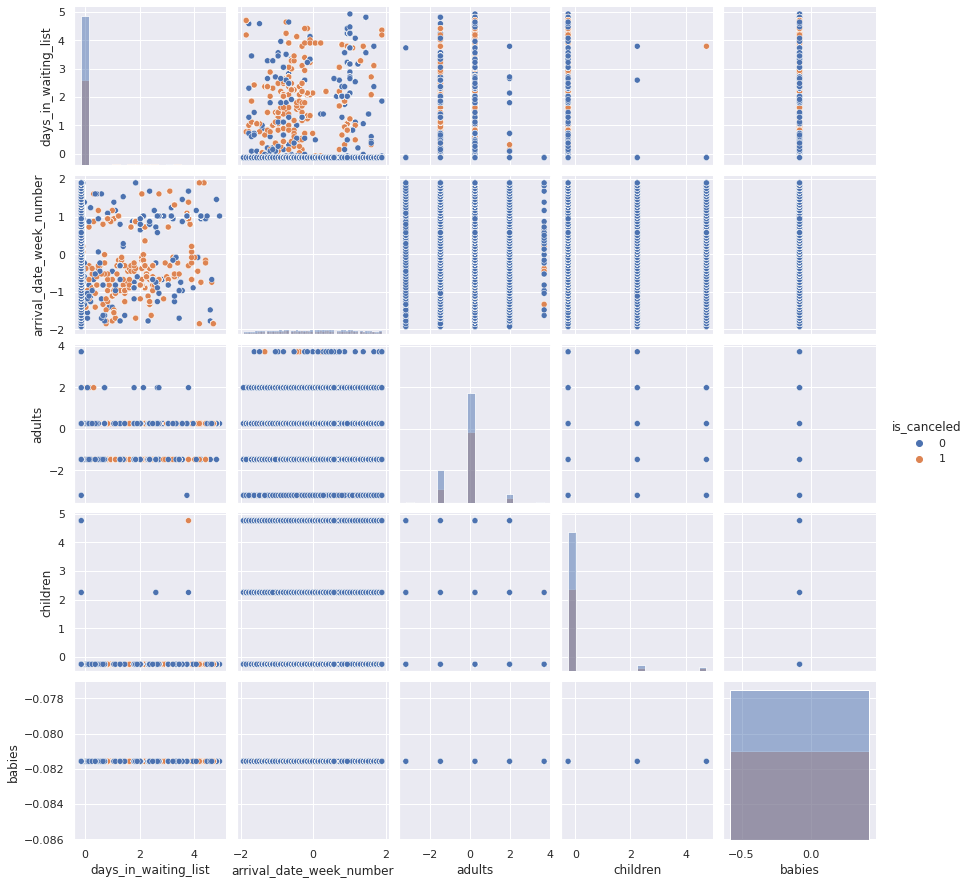

In [58]:
# just a second pair plot to read they get cumbersome quickly
sns.pairplot(normed_full_nol[['is_canceled','days_in_waiting_list', 'arrival_date_week_number', 'adults', 'children', 'babies']], 
             diag_kind = 'hist', hue= 'is_canceled' )

In [59]:
#Function for min_max_value details:
def min_max_values (col):
  top = hotel[col].idxmax()
  top_obs = pd.DataFrame(hotel.loc[top])

  bottom = hotel[col].idxmin()
  bottom_obs = pd.DataFrame(hotel.loc[bottom])

  min_max_obs = pd.concat([top_obs, bottom_obs], axis=1)

  return min_max_obs

In [60]:
# run this function for each our target variables, adr, total_revenue, 
min_max_values('adr')

,48515,0
hotel,City Hotel,Resort Hotel
is_canceled,1,0
lead_time,35,342
arrival_date_week_number,13,27
stays_in_weekend_nights,0,0
stays_in_week_nights,1,0
adults,2,2
children,0,0
babies,0,0
meal,BB,BB


In [61]:
hotel.head()

,hotel,is_canceled,lead_time,arrival_date_week_number,stays_in_weekend_nights,stays_in_week_nights,adults,children,babies,meal,...,customer_type,adr,required_car_parking_spaces,total_of_special_requests,reservation_status,reservation_status_date,arrival_date,length_of_stay,departure_date,total_revenue
0,Resort Hotel,0,342,27,0,0,2,0.0,0,BB,...,Transient,0.0,0,0,Check-Out,2015-07-01,2015-07-01,0,2015-07-01,0.0
1,Resort Hotel,0,737,27,0,0,2,0.0,0,BB,...,Transient,0.0,0,0,Check-Out,2015-07-01,2015-07-01,0,2015-07-01,0.0
2,Resort Hotel,0,7,27,0,1,1,0.0,0,BB,...,Transient,75.0,0,0,Check-Out,2015-07-02,2015-07-01,1,2015-07-02,75.0
3,Resort Hotel,0,13,27,0,1,1,0.0,0,BB,...,Transient,75.0,0,0,Check-Out,2015-07-02,2015-07-01,1,2015-07-02,75.0
4,Resort Hotel,0,14,27,0,2,2,0.0,0,BB,...,Transient,98.0,0,1,Check-Out,2015-07-03,2015-07-01,2,2015-07-03,196.0


# New Features

See -  
- <a target="_self" href="https://colab.research.google.com/drive/1AoIKPl-hSjqTj-gzBb7u9xEGqDZxO9Kt#scrollTo=lyZPOEyCeeYv&line=1&uniqifier=1">Data Quality: Adding New Features</a> 
- <a target="_self" href="https://colab.research.google.com/drive/1AoIKPl-hSjqTj-gzBb7u9xEGqDZxO9Kt#scrollTo=FYzicb6H5RNN&line=1&uniqifier=1">Data Meaning and Type: Descriptions</a> 

# Exceptional Work

In [62]:
# preprocessing for pca analysis, dropping the 4 nan rows all from children
# adapted from https://scikit-learn.org/stable/modules/generated/sklearn.decomposition.PCA.html
# how many rows original dataframe had
print(len(hotelCont_mean_normed))

# determine where nan's are
is_NaN = hotelCont_mean_normed.isnull()
row_has_NaN = is_NaN.any(axis=1)
rows_with_NaN = hotelCont_mean_normed[row_has_NaN]
print(rows_with_NaN)

# remove nan rows
hotelCont_mean_normed.drop(axis = 0, index = rows_with_NaN.index, inplace = True)

# checking that the 4 rows are gone
print(len(hotelCont_mean_normed))


119390
Empty DataFrame
Columns: [is_canceled, lead_time, arrival_date_week_number, stays_in_weekend_nights, stays_in_week_nights, length_of_stay, previous_cancellations, previous_bookings_not_canceled, booking_changes, days_in_waiting_list, adr, required_car_parking_spaces, total_of_special_requests, adults, children, babies, total_revenue]
Index: []
119390


In [63]:
# https://scikit-learn.org/stable/modules/generated/sklearn.decomposition.PCA.html

from sklearn.decomposition import PCA
pca = PCA(n_components=len(hotel_nol.columns))
pca.fit(hotel_nol)

PCA(n_components=17)

In [64]:
# visuallizing some PCA, not super useful since we dont have issues with correlation, unless we can discern something from the PCs
# adapted from https://plotly.com/python/pca-visualization/

import plotly.express as px

components = pca.fit_transform(hotel_nol)
total_var = pca.explained_variance_ratio_.sum() * 100
n_components = 4

fig = px.scatter_matrix(
    components,
    color=hotel_nol.is_canceled,
    dimensions=range(n_components),
    title=f'Total Explained Variance: {total_var:.2f}%',
)
fig.show()

In [65]:
# the components are all very small 
pca.components_

array([[ 9.09191068e-03,  1.30893656e-01,  6.43705395e-02,
         4.10806466e-01,  4.48123487e-01,  4.94785857e-01,
        -1.36434400e-02, -2.29343627e-02,  3.71441398e-02,
        -1.39810706e-02,  2.29676419e-01, -3.29856023e-03,
         1.35920813e-01,  1.61022425e-01,  1.31382128e-01,
         0.00000000e+00,  4.97531496e-01],
       [-9.43376557e-02, -4.01516669e-01, -1.43178980e-02,
        -1.66178123e-01, -1.90068797e-01, -2.06712002e-01,
        -4.48157912e-02,  5.81187847e-03,  4.00678780e-02,
        -3.45209766e-02,  5.04912602e-01,  2.99206732e-01,
         3.85870250e-01,  1.46517994e-01,  4.35060791e-01,
         0.00000000e+00,  1.19442735e-01],
       [-1.44113113e-01, -5.29926330e-01, -6.11528344e-01,
         1.99149464e-01,  1.30320443e-01,  1.75003989e-01,
        -4.99085766e-02,  3.52473860e-02,  7.38880306e-02,
        -3.14244315e-02, -2.79841050e-01,  2.48136437e-01,
         9.08069707e-02, -2.04252674e-01, -1.91883350e-01,
        -0.00000000e+00, -1.8